In [95]:
# Based on the following blog post
# https://austinrochford.com/posts/2021-07-05-factor-analysis-pymc3.html

In [113]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl

from astropy.table import Table
from astropy.table import join

mpl.rcParams["figure.dpi"] = 100

df = pd.read_parquet('./data.parquet')
df.head()
print(np.shape(df))

#Santos et al. 2021
san = pd.read_csv('/Users/tdavid/GitHub/rotation-ridge/data/santos2021/S21_rotators.csv')
san = san.add_prefix('san_')
#san.head()

df = df.merge(san, how='left', left_on='kepid', right_on='san_KIC')

print(np.shape(df))
df = df.drop_duplicates(subset=['kepid'], keep='first')
print(np.shape(df))

len(df[np.isfinite(df['bf18_[Fe/H]'])])

from sklearn.linear_model import LinearRegression

regression_cols = []

for col in df.columns:
    if ("bf18_[" in col) & ("/H]" in col) & (col!="bf18_[M/H]"):
    #if ("bf18_[" in col):
        regression_cols.append(col)
        
        
# for col in (["p20_cks_steff",
#             "p20_cks_slogg",
#             "p20_cks_smet",
#             "p20_cks_svsini",
#             "cks_logAiso"]):

for col in (["p20_cks_steff",
            "p20_cks_slogg",
            "p20_cks_smet",
            "p20_cks_svsini",
            "p20_iso_sage"]):
                
    regression_cols.append(col)

regression_cols = np.array(regression_cols)
print(regression_cols)

data = df[regression_cols]
data.head()

data = data.dropna(subset=regression_cols) 

pd.set_option('display.max_rows', 130)
data.isna().sum()

(9750, 1371)
(9750, 1393)
(8214, 1393)
['bf18_[C/H]' 'bf18_[N/H]' 'bf18_[O/H]' 'bf18_[Na/H]' 'bf18_[Mg/H]'
 'bf18_[Al/H]' 'bf18_[Si/H]' 'bf18_[Ca/H]' 'bf18_[Ti/H]' 'bf18_[V/H]'
 'bf18_[Cr/H]' 'bf18_[Mn/H]' 'bf18_[Fe/H]' 'bf18_[Ni/H]' 'bf18_[Y/H]'
 'p20_cks_steff' 'p20_cks_slogg' 'p20_cks_smet' 'p20_cks_svsini'
 'p20_iso_sage']


bf18_[C/H]        0
bf18_[N/H]        0
bf18_[O/H]        0
bf18_[Na/H]       0
bf18_[Mg/H]       0
bf18_[Al/H]       0
bf18_[Si/H]       0
bf18_[Ca/H]       0
bf18_[Ti/H]       0
bf18_[V/H]        0
bf18_[Cr/H]       0
bf18_[Mn/H]       0
bf18_[Fe/H]       0
bf18_[Ni/H]       0
bf18_[Y/H]        0
p20_cks_steff     0
p20_cks_slogg     0
p20_cks_smet      0
p20_cks_svsini    0
p20_iso_sage      0
dtype: int64

In [115]:
data.head()

,bf18_[C/H],bf18_[N/H],bf18_[O/H],bf18_[Na/H],bf18_[Mg/H],bf18_[Al/H],bf18_[Si/H],bf18_[Ca/H],bf18_[Ti/H],bf18_[V/H],bf18_[Cr/H],bf18_[Mn/H],bf18_[Fe/H],bf18_[Ni/H],bf18_[Y/H],p20_cks_steff,p20_cks_slogg,p20_cks_smet,p20_cks_svsini,p20_iso_sage
0,-0.00,-0.02,0.08,-0.04,0.03,0.01,-0.01,0.04,0.04,0.02,0.06,0.04,0.03,0.01,0.09,5538.9,4.443,0.102,0.8,7.943282
5,0.08,-0.24,0.09,0.01,0.07,0.12,0.12,0.15,0.15,0.07,0.17,-0.04,0.12,0.07,0.09,5660.3,4.258,0.177,2.6,9.120108
9,0.32,-0.44,0.48,-0.03,-0.04,-0.07,0.01,0.06,0.09,-0.01,0.11,0.04,0.04,-0.03,0.38,5001.6,4.678,0.062,2.1,5.888437
10,-0.00,0.05,-0.03,-0.11,-0.04,-0.12,0.00,0.03,0.00,-0.03,-0.02,-0.07,-0.01,-0.08,0.10,5818.8,4.400,0.012,1.3,5.623413
11,0.01,0.29,0.35,0.02,0.10,0.13,0.19,0.35,0.28,0.07,0.24,-0.11,0.24,0.13,0.51,6448.7,4.134,0.203,5.2,2.264644


In [116]:
from sklearn.decomposition import FactorAnalysis, PCA
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import load_iris

In [119]:
data.head()

,bf18_[C/H],bf18_[N/H],bf18_[O/H],bf18_[Na/H],bf18_[Mg/H],bf18_[Al/H],bf18_[Si/H],bf18_[Ca/H],bf18_[Ti/H],bf18_[V/H],bf18_[Cr/H],bf18_[Mn/H],bf18_[Fe/H],bf18_[Ni/H],bf18_[Y/H],p20_cks_steff,p20_cks_slogg,p20_cks_smet,p20_cks_svsini,p20_iso_sage
0,-0.00,-0.02,0.08,-0.04,0.03,0.01,-0.01,0.04,0.04,0.02,0.06,0.04,0.03,0.01,0.09,5538.9,4.443,0.102,0.8,7.943282
5,0.08,-0.24,0.09,0.01,0.07,0.12,0.12,0.15,0.15,0.07,0.17,-0.04,0.12,0.07,0.09,5660.3,4.258,0.177,2.6,9.120108
9,0.32,-0.44,0.48,-0.03,-0.04,-0.07,0.01,0.06,0.09,-0.01,0.11,0.04,0.04,-0.03,0.38,5001.6,4.678,0.062,2.1,5.888437
10,-0.00,0.05,-0.03,-0.11,-0.04,-0.12,0.00,0.03,0.00,-0.03,-0.02,-0.07,-0.01,-0.08,0.10,5818.8,4.400,0.012,1.3,5.623413
11,0.01,0.29,0.35,0.02,0.10,0.13,0.19,0.35,0.28,0.07,0.24,-0.11,0.24,0.13,0.51,6448.7,4.134,0.203,5.2,2.264644


In [124]:
X = StandardScaler().fit_transform(data)
#X = StandardScaler().fit_transform(data["data"])
#feature_names = data["feature_names"]

In [105]:
from warnings import filterwarnings
#from aesara import tensor as at
import aesara_theano_fallback.tensor as at
import arviz as az
from matplotlib import pyplot as plt
import numpy as np
import pymc3 as pm
import seaborn as sns

filterwarnings('ignore', category=RuntimeWarning, module='arviz')
filterwarnings('ignore', category=UserWarning, module='arviz')
filterwarnings('ignore', category=UserWarning, module='pandas')

plt.rcParams['figure.figsize'] = (8, 6)
sns.set(color_codes=True)

In [106]:
# print(np.shape(data))
# print(np.shape(Y))
# print(np.shape(X))

# N = np.shape(data)[0]  # size of sample
# M = np.shape(data)[1]  # dimensionality of observed targets
# K = 6                  # dimensionality of latent variable vector

In [107]:
# extra step to allow graphviz to be found 
import os
#os.environ["PATH"] += os.pathsep + 'C:/Users/jed/Anaconda3/envs/keras/Library/bin/graphviz/'
os.environ["PATH"] += os.pathsep + '/Users/tdavid/opt/anaconda3/lib/python3.8/site-packages/graphviz/'

In [108]:
# J = 8
# y = np.array([28.,  8., -3.,  7., -1.,  1., 18., 12.])
# sigma = np.array([15., 10., 16., 11.,  9., 11., 10., 18.])

# with pm.Model() as non_centered_eight:
#     mu = pm.Normal('mu', mu=0, sd=5)
#     tau = pm.HalfCauchy('tau', beta=5)
#     theta_tilde = pm.Normal('theta_t', mu=0, sd=1, shape=J)
#     theta = pm.Deterministic('theta', mu + tau * theta_tilde)
#     obs = pm.Normal('obs', mu=theta, sd=sigma, observed=y)

# pm.model_to_graphviz(non_centered_eight)

# Example

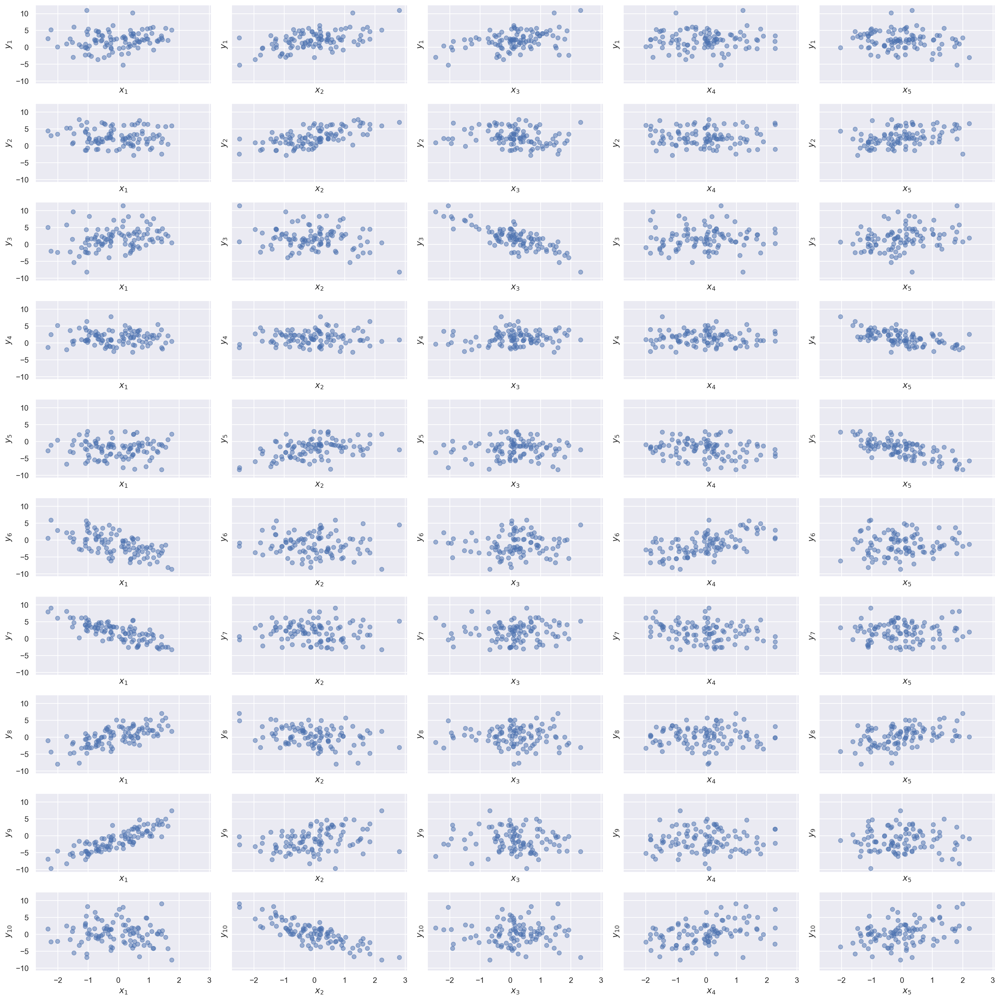

In [109]:
SEED = 123456789 # for reproducibility

rng = np.random.default_rng(SEED)

# The observed predictors, 𝐱𝑖, will be 5-dimensional vectors with entries drawn 
# i.i.d. from the standard normal distribution. We generate 100 such vectors.

N = 100 #Size of sample
K = 5 #Dimensionality of latent variable vector
X = rng.normal(size=(N, K))


# The observed targets, 𝐲𝑖, will be 10-dimensional vectors.
# The constant term for this model, 𝐵0, is therefore a random vector in ℝ10 whose entries are i.i.d. drawn from the uniform distribution on [−3,3].

M = 10 #Dimensionality of observed targets

B0 = rng.uniform(-3., 3., size=M)

# The component slopes form a 10×5 dimensional matrix. 
# We generate a somewhat sparse matrix that has only (approximately) 50% of entries nonzero. 
# These entries are also i.i.d. from the uniform distribution on [−3,3].

B = np.zeros((M, K))
P_nonzero = 0.5

is_nonzero = np.random.binomial(1, P_nonzero, size=(M, K)) == 1
B[is_nonzero] = rng.uniform(-3., 3., size=is_nonzero.sum())

#The observations before noise are
#𝐲noiseless𝑖=𝐵0+𝐵 𝐱𝑖.

Y_noiseless = B0 + X.dot(B.T)

#So far this is a fairly standard simulation from a linear regression model. Things start to get more interesting when we introduce a non-diagonal correlation structure to the noise using latent factors. The noise added to the 𝑗-th component of the 𝑖-th sample is

#𝜀𝑖,𝑗=𝐰𝑗⋅𝐳𝑖+𝜎𝑖,𝑗

#where 𝐰1,⋯𝐰10, and 𝐳1,…,𝐳100 are vectors in ℝ2 whose entries are drawn i.i.d. from a standard normal distribution. Here two is the number of latent factors that govern the covariance structure. The uncorrelated noise is drawn i.i.d. from a normal distribution with variance (0.25)2.

F = 2 #Number of latent factors that govern the covariance structure

S_SCALE = 1.

W = rng.normal(size=(M, F))
Z = rng.normal(size=(N, F))

S = rng.normal(scale=S_SCALE, size=(N, M))

Y = Y_noiseless + Z.dot(W.T) + S

fig, axes = plt.subplots(nrows=M, ncols=K,
                         sharex=True, sharey=True,
                         figsize=(20, 20))

for j, row_axes in enumerate(axes):
    for i, ax in enumerate(row_axes):
        ax.scatter(X[:, i], Y[:, j], alpha=0.5);

        ax.set_xlabel(f"$x_{{{i + 1}}}$");
        ax.set_ylabel(f"$y_{{{j + 1}}}$");

fig.tight_layout();

In [110]:
import pymc3_ext as pmx

print(np.shape(data))
print(np.shape(Y))
print(np.shape(X))

# X: latent variable vector --> draw from multivariate normal
# Y: observations, shape (N, M)

# N = np.shape(data)[0]  # size of sample
# M = np.shape(data)[1]  # dimensionality of observed targets
# K = 6                  # dimensionality of latent variable vector
# F = 2 #Number of latent factors that govern the covariance structure

# Beta0: constant, shape=M
# Beta: slopes, shape=(M,K)
# mu: model mean
# sigma: model scatter
# w and z are to capture correlated noise

(928, 20)
(100, 10)
(100, 5)


In [111]:
#pm.model_to_graphviz(factor_model)

In [112]:
# gv = pm.model_to_graphviz(factor_model)
# gv.render("graphname", format="png")

In [90]:
# Y: observations, shape (N, M)
# Y = data
N = np.shape(data)[0]  # size of sample
M = np.shape(data)[1]  # dimensionality of observed targets
K = 6                  # dimensionality of latent variable vector
F = 2 #Number of latent factors that govern the covariance structure

X = rng.normal(size=(N, K))

with pm.Model() as factor_model:

    ################
    # Latent variables
    #X = pm.Normal("X", 0., 5., shape=(N, K))
    ################
    
    β0 = pm.Normal("β0", 0., 5., shape=M)
    β = pm.Normal("β", 0., 5., shape=(M, K))
    μ = β0 + at.dot(X, β.T)
    σ = pm.HalfNormal("σ", 2.5)
    
    w = pm.Normal("w", 0., 1., shape=(M, F))
    z = pm.Normal("z", 0., 1., shape=(N, F))
    obs = pm.Normal("obs", μ + z.dot(w.T), σ, observed=Y)    
    
    # Optimize to find the maximum a posteriori parameters
    map_soln = pmx.optimize()
     
# with factor_model:
    
#     w = pm.Normal("w", 0., 1., shape=(M, F))
#     z = pm.Normal("z", 0., 1., shape=(N, F))
#     obs = pm.Normal("obs", μ + z.dot(w.T), σ, observed=Y)

optimizing logp for variables: [z, w, σ, β, β0, X]


AttributeError: 'NoneType' object has no attribute 'message'

In [81]:
map_soln

{'X': array([[0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
     

In [82]:
CORES = 4

SAMPLE_KWARGS = {
    'cores': CORES,
    'init': 'adapt_diag',
    'random_seed': [SEED + i for i in range(CORES)],
    'return_inferencedata': True
}

START_MULT = 3.

START_CORNERS = np.array([
    [1., 1.],
    [-1., 1.],
    [-1., -1.],
    [1., -1.]
])

w_starts = [
    {"w": w_start, "z": np.ones((N, F))} for w_start
        in START_MULT * np.ones((1, M, F)) * START_CORNERS[:, np.newaxis]
]

In [83]:
with factor_model:
    #factor_trace = pm.sample(start=w_starts, **SAMPLE_KWARGS)
    factor_trace = pm.sample(start=map_soln, **SAMPLE_KWARGS)

Auto-assigning NUTS sampler...
Initializing NUTS using adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [z, w, σ, β, β0, X]


Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 187 seconds.
The number of effective samples is smaller than 25% for some parameters.


In [84]:
def make_diagnostic_plots(trace, axes=None,
                          min_mult=0.995, max_mult=1.005,
                          var_names=None):
    if axes is None:
        fig, axes = plt.subplots(ncols=2,
                                 sharex=False, sharey=False,
                                 figsize=(16, 6))
        
    az.plot_energy(trace, ax=axes[0])
    
    
    rhat = az.rhat(trace, var_names=var_names).max()
    axes[1].barh(np.arange(len(rhat.variables)), rhat.to_array(),
                 tick_label=list(rhat.variables.keys()))
    axes[1].axvline(1, c='k', ls='--')

    axes[1].set_xlim(
        min_mult * min(rhat.min().to_array().min(), 1),
        max_mult * max(rhat.max().to_array().max(), 1)
    )
    axes[1].set_xlabel(r"$\hat{R}$")

    axes[1].set_ylabel("Variable")
    
    return fig, axes

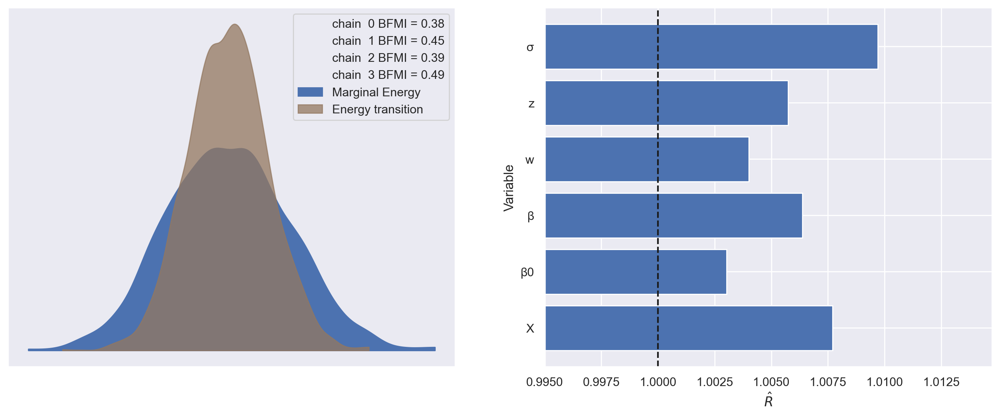

In [85]:
make_diagnostic_plots(factor_trace);

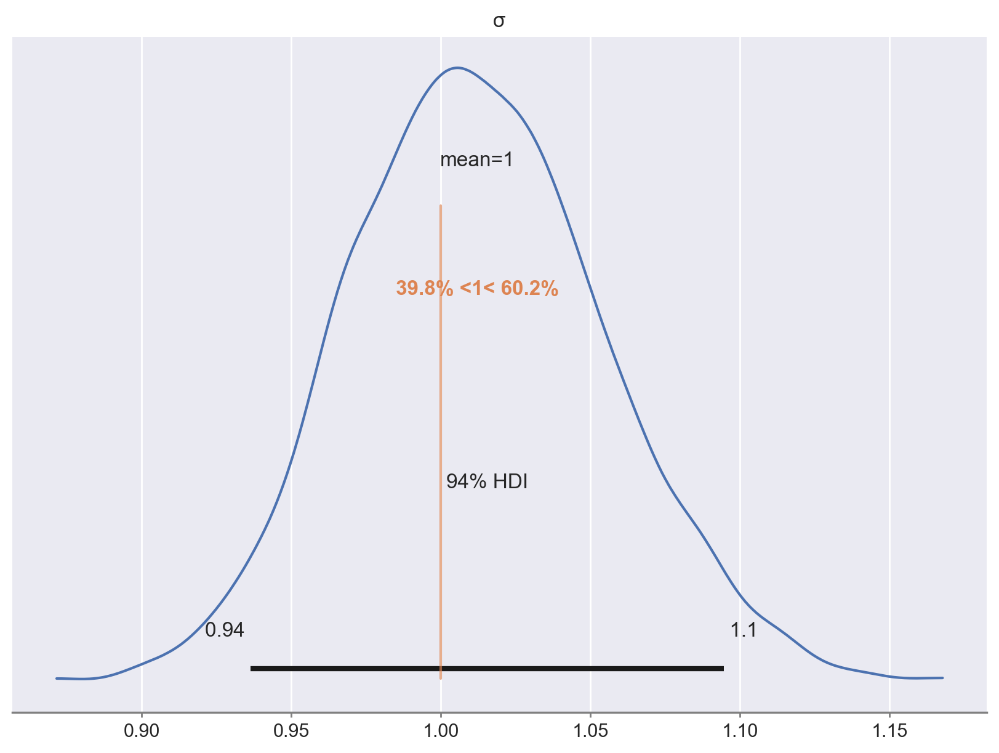

In [86]:
az.plot_posterior(factor_trace, var_names="σ", ref_val=S_SCALE);

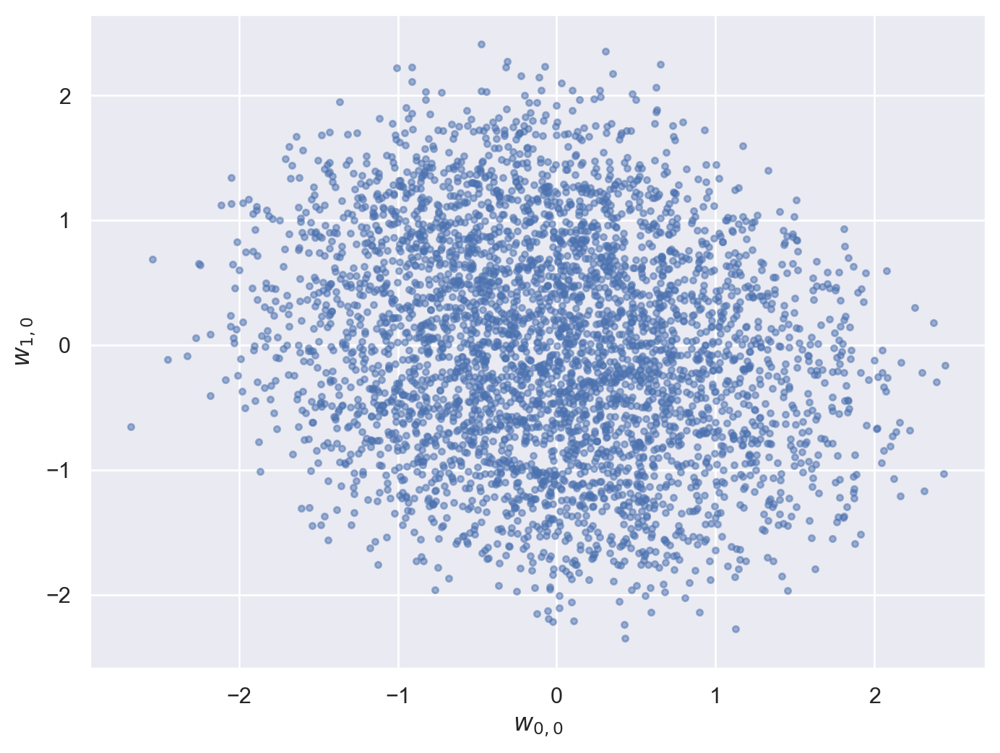

In [87]:
ax = az.plot_pair(factor_trace, var_names="w",
                  coords={"w_dim_0": [0, 1], "w_dim_1": 0},
                  scatter_kwargs={'alpha': 0.5})

ax.set_xlabel("$w_{0, 0}$");
ax.set_ylabel("$w_{1, 0}$");

In [88]:
axes = az.plot_pair(factor_trace, var_names="w",
                   scatter_kwargs={'alpha': 0.5})

for ax in axes.flat:
    ax.set_xlabel(None);
    ax.set_ylabel(None);

axes[0, 0].figure.tight_layout();

The dataframe has a row entry for each KOI, meaning individual star are represented N times where N is the number of KOIs detected around that star so we drop duplicates.

,san_KIC,san_Kp,san_q_first,san_q_last,san_Teff,san_E_Teff,san_e_Teff,san_logg,san_E_logg,san_e_logg,...,san_e_mass,san_Prot,san_E_prot,san_Sph,san_E_Sph,san_Flag_Type1CPCB,san_Flag_MSSG,san_Flag_Binary,san_Flag_KOI,san_Flag_Source
0,757099,13.152,1,17,5364.9,102.7,84.9,4.318,0.037,0.029,...,0.039,0.36,0.02,15463.8,1668.0,1,1,0,-999,0
1,757450,15.264,1,17,5301.2,111.0,103.1,4.432,0.045,0.044,...,0.057,19.12,1.50,3756.4,118.7,-999,1,0,0,0
2,891916,14.799,1,17,5650.8,131.9,137.7,4.132,0.224,0.254,...,0.112,5.45,0.42,3409.6,199.2,-999,1,-999,-999,0
3,892195,13.757,1,17,5333.4,101.3,84.2,4.372,0.039,0.029,...,0.040,21.78,2.90,212.9,4.7,-999,1,0,-999,0
4,892713,12.082,0,17,6238.9,123.4,129.8,3.548,0.066,0.037,...,0.087,5.78,0.76,390.4,11.9,-999,1,0,-999,0


In [14]:
### Nissen et al. 2020 solar twin sample

# nis_t1 = Table.read("http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/table1.dat",
#                 readme="http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/ReadMe",
#                 format="ascii.cds")

# nis_t2 = Table.read("http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/table2.dat",
#                 readme="http://cdsarc.unistra.fr/ftp/J/A+A/640/A81/ReadMe",
#                 format="ascii.cds")

# nis = join(nis_t1,nis_t2)

# nis['ymg_ratio'] = nis['[Y/Fe]'] - nis['[Mg/Fe]']
# nis['yal_ratio'] = nis['[Y/Fe]'] - nis['[Al/Fe]']

# nis = nis.to_pandas()
# nis = nis.replace(9.999, np.nan)

# nis.head()

,HD,Teff,logg-sp,Vturb,[Fe/H],[alpha/Fe],Zs,logL,Age,e_Age,...,[Al/Fe],[Si/Fe],[Ca/Fe],[Ti/Fe],[Cr/Fe],[Ni/Fe],[Sr/Fe],[Y/Fe],ymg_ratio,yal_ratio
0,361,5892,4.524,1.05,-0.130,-0.003,0.0135,-0.021,1.5,0.9,...,-0.042,-0.013,0.027,0.019,0.002,-0.056,0.106,0.079,0.093,0.121
1,1461,5760,4.372,1.03,0.190,0.009,0.0275,0.077,5.5,0.5,...,0.044,0.014,-0.016,0.007,0.005,0.045,-0.052,-0.039,-0.046,-0.083
2,2071,5724,4.486,0.96,-0.087,0.013,0.0152,-0.076,4.1,0.9,...,-0.001,0.002,0.024,0.029,0.005,-0.029,0.032,0.039,0.038,0.040
3,4915,5662,4.513,0.93,-0.212,0.042,0.0121,-0.154,3.8,1.3,...,0.020,0.014,0.045,0.064,0.006,-0.037,0.036,0.032,-0.016,0.012
4,6204,5857,4.517,1.05,0.046,-0.038,0.0188,-0.034,-0.4,1.0,...,-0.078,-0.044,0.019,-0.009,0.005,-0.064,0.129,0.122,0.184,0.200


In [28]:
# sc_kws = {'s':6, 'cmap': 'viridis'}

# cks_teff = df['p20_cks_steff']
# cks_logg = df['p20_cks_slogg']
# cks_feh  = df['p20_cks_smet']
# cks_age  = df['cks_age']

# bf_teff = df['bf18_Teff']
# bf_logg = df['bf18_log(g)']
# bf_feh  = df['bf18_[Fe/H]']
# bf_age  = df['bf18_Age']

# yal = df["bf18_[Y/Al]"]
# ymg = df["bf18_[Y/Mg]"]

# plt.scatter(cks_teff, cks_logg, c=yal, vmin=-0.3, vmax=0.3, **sc_kws)
# plt.xlim(7000,4500)
# plt.ylim(5,3)
# plt.colorbar(label='[Y/Al]')
# plt.xlabel('Teff [K]')
# plt.ylabel('log(g) [dex]')
# plt.show()

In [29]:
# fig, ax = plt.subplots(nrows=2,ncols=3, figsize=(12,6))

# for i,el in enumerate(['Y','Mg','Al']):
#     sc = ax[0][i].scatter(cks_age, df['bf18_['+el+'/H]'], c=cks_feh, **sc_kws)
#     ax[0][i].set_ylabel('['+el+'/H]')
#     ax[0][i].set_xlabel('Age [Gyr]')
#     cb = fig.colorbar(sc, ax=ax[0][i])
#     cb.set_label('[Fe/H]')
    
#     sc = ax[1][i].scatter(cks_age, df['bf18_['+el+'/Fe]'], c=cks_teff, **sc_kws)
#     ax[1][i].set_ylabel('['+el+'/Fe]')
#     ax[1][i].set_xlabel('Age [Gyr]')    
#     cb = fig.colorbar(sc, ax=ax[1][i])
#     cb.set_label('Teff [K]')
    
    
# plt.tight_layout()

['bf18_[M/H]' 'bf18_[C/H]' 'bf18_[N/H]' 'bf18_[O/H]' 'bf18_[Na/H]'
 'bf18_[Mg/H]' 'bf18_[Al/H]' 'bf18_[Si/H]' 'bf18_[Ca/H]' 'bf18_[Ti/H]'
 'bf18_[V/H]' 'bf18_[Cr/H]' 'bf18_[Mn/H]' 'bf18_[Fe/H]' 'bf18_[Ni/H]'
 'bf18_[Y/H]' 'bf18_[C/Fe]' 'bf18_[N/Fe]' 'bf18_[O/Fe]' 'bf18_[Na/Fe]'
 'bf18_[Mg/Fe]' 'bf18_[Al/Fe]' 'bf18_[Si/Fe]' 'bf18_[Ca/Fe]'
 'bf18_[Ti/Fe]' 'bf18_[V/Fe]' 'bf18_[Cr/Fe]' 'bf18_[Mn/Fe]' 'bf18_[Ni/Fe]'
 'bf18_[Y/Fe]' 'bf18_[Y/Ni]' 'bf18_[Y/Mn]' 'bf18_[Y/Cr]' 'bf18_[Y/V]'
 'bf18_[Y/Ti]' 'bf18_[Y/Ca]' 'bf18_[Y/Si]' 'bf18_[Y/Al]' 'bf18_[Y/Mg]'
 'bf18_[Y/Na]' 'bf18_[Y/O]' 'bf18_[Y/N]' 'bf18_[Y/C]' 'bf18_[Ni/Mn]'
 'bf18_[Ni/Cr]' 'bf18_[Ni/V]' 'bf18_[Ni/Ti]' 'bf18_[Ni/Ca]' 'bf18_[Ni/Si]'
 'bf18_[Ni/Al]' 'bf18_[Ni/Mg]' 'bf18_[Ni/Na]' 'bf18_[Ni/O]' 'bf18_[Ni/N]'
 'bf18_[Ni/C]' 'bf18_[Mn/Cr]' 'bf18_[Mn/V]' 'bf18_[Mn/Ti]' 'bf18_[Mn/Ca]'
 'bf18_[Mn/Si]' 'bf18_[Mn/Al]' 'bf18_[Mn/Mg]' 'bf18_[Mn/Na]' 'bf18_[Mn/O]'
 'bf18_[Mn/N]' 'bf18_[Mn/C]' 'bf18_[Cr/V]' 'bf18_[Cr/Ti]' 'bf18_[Cr/Ca]'
 'bf

,bf18_[M/H],bf18_[C/H],bf18_[N/H],bf18_[O/H],bf18_[Na/H],bf18_[Mg/H],bf18_[Al/H],bf18_[Si/H],bf18_[Ca/H],bf18_[Ti/H],...,bf18_[N/C],bf18_[alpha/Fe],p20_cks_steff,p20_cks_slogg,p20_cks_smet,p20_cks_svsini,p20_iso_sage,cks_age,bf18_Age,san_Prot
0,0.03,-0.00,-0.02,0.08,-0.04,0.03,0.01,-0.01,0.04,0.04,...,-0.02,-0.010000,5538.9,4.443,0.102,0.8,7.943282,3.981072,8.94,22.58
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.81
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,0.09,0.08,-0.24,0.09,0.01,0.07,0.12,0.12,0.15,0.15,...,-0.32,-0.006667,5660.3,4.258,0.177,2.6,9.120108,6.760830,11.77,NaN


In [20]:
# X = data.drop('cks_logAiso', axis=1)
# y = data['cks_logAiso']

X = data.drop('p20_iso_sage', axis=1)
y = data['p20_iso_sage']

# X = data.drop('bf18_Age', axis=1)
# y = data['bf18_Age']

from sklearn.model_selection import train_test_split
train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.3, random_state=2)

from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(train_X, train_y)
print("Score on training set :", reg.score(train_X, train_y))
print("Score on test set     :", reg.score(test_X, test_y))

from sklearn import linear_model
lasso_reg = linear_model.Lasso(alpha=1e-5, max_iter=100, tol=0.1)
lasso_reg.fit(train_X, train_y)
print("Lasso regression")
print(lasso_reg.score(train_X, train_y))
print(lasso_reg.score(test_X, test_y))

In [24]:
for age_col in ['p20_iso_sage', 'cks_age', 'bf18_Age']:

    plt.clf()

    fig,axes = plt.subplots(nrows=11,ncols=12, figsize=(25,25))
    axs = axes.reshape(-1)

    for i,col in enumerate(data.columns):
        #axs[i].plot(data['cks_logAiso'], data[col], 'o', ms=1, alpha=0.5)
        #axs[i].plot(data['p20_iso_sage'], data[col], 'o', ms=1, alpha=0.5)
        axs[i].hist2d(data[age_col], data[col], bins=20, cmap='Blues',
                     range=[[0,14],[np.percentile(data[col],1),np.percentile(data[col],99)]])
        #axs[i].plot(data['bf18_Age'], data[col], 'o', ms=1, alpha=0.5)
        axs[i].set_title(col)
        axs[i].set_xticks([])
        axs[i].set_yticks([])
        #axs[i].set_ylim(np.percentile(data[col],0.5),np.percentile(data[col],99.5))

    for i in range(130,132):
        axs[i].axis('off')
        
    #plt.tight_layout()
    plt.subplots_adjust(wspace=0)
    plt.savefig('./figures/'+age_col+'-grid.pdf', dpi=150, bbox_inches='tight')
    plt.close()

<Figure size 600x400 with 0 Axes>

### CKS sample: Linear regression with abundances normalized to H

Adjusted R-squared: 0.4605401081347711
Feature: 0, Score: -24.10096 [Fe/H]
Feature: 1, Score: -11.15745 [Ti/H]
Feature: 2, Score: -6.61258 [Y/H]
Feature: 3, Score: -1.18567 [N/H]
Feature: 4, Score: -0.44725 [C/H]
Feature: 5, Score: -0.17119 [Ni/H]
Feature: 6, Score: -0.14654 [Cr/H]
Feature: 7, Score: 0.24702 [O/H]
Feature: 8, Score: 1.63691 [V/H]
Feature: 9, Score: 2.80421 [Al/H]
Feature: 10, Score: 3.68978 [Na/H]
Feature: 11, Score: 4.01232 [Ca/H]
Feature: 12, Score: 4.40547 [Si/H]
Feature: 13, Score: 7.56810 [Mn/H]
Feature: 14, Score: 14.58439 [Mg/H]


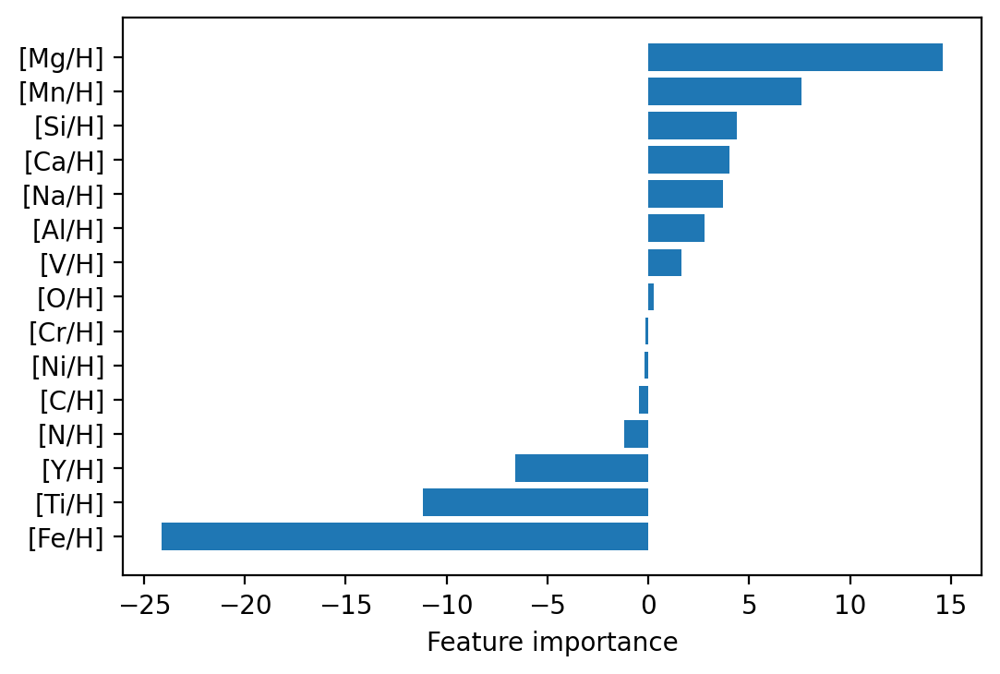

In [27]:
#Drop NaNs
df = df[df['bf18_Age'].notna()]
df = df[df['cks_age'].notna()]

from sklearn.linear_model import LinearRegression

regression_cols = []

#regression_cols.append("bf18_Teff")
#regression_cols.append("bf18_log(g)")

for col in df.columns:
    if ("bf18_[" in col) & ("/H]" in col) & (col!="bf18_[M/H]"):
        regression_cols.append(col)

regression_cols = np.array(regression_cols)
regressor_labels = [s.split("bf18_")[1] for s in regression_cols]
regressor_labels = np.array(regressor_labels)


#There are some pretty significant outliers which screw up the regression. Let's remove those.
for col in regression_cols:
    df = df[abs(df[col])<3]


model = LinearRegression()
X, y = df[regression_cols], df.bf18_Age
model.fit(X, y)

#Adjusted R-squared
print('Adjusted R-squared:', 1 - (1-model.score(X, y))*(len(y)-1)/(len(y)-X.shape[1]-1))

# Get importance
importance = model.coef_
order = np.argsort(importance)
importance = importance[order]
regressor_labels = regressor_labels[order]

# Summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v), regressor_labels[i])
# Plot feature importance
plt.barh([x for x in range(len(importance))], importance)
plt.yticks(np.arange(len(importance)), regressor_labels)
plt.xlabel("Feature importance")
plt.show()

### CKS sample: Linear regression with abundances normalized to Fe

Adjusted R-squared: 0.5667187772183608
Feature: 0, Score: -9.89240
Feature: 1, Score: -6.04765
Feature: 2, Score: -2.48088
Feature: 3, Score: -2.31454
Feature: 4, Score: -0.31887
Feature: 5, Score: 0.23307
Feature: 6, Score: 0.58760
Feature: 7, Score: 0.78426
Feature: 8, Score: 0.94282
Feature: 9, Score: 2.25067
Feature: 10, Score: 3.05476
Feature: 11, Score: 3.24844
Feature: 12, Score: 3.40676
Feature: 13, Score: 4.19165
Feature: 14, Score: 7.07803
Feature: 15, Score: 7.97780


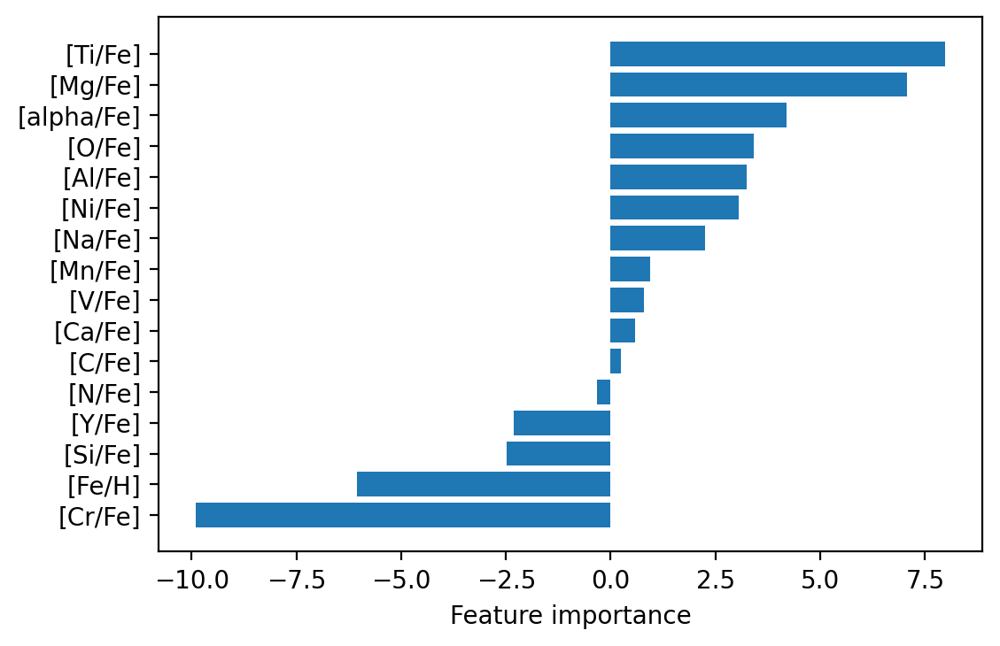

In [34]:
regression_cols = []
#regression_cols.append("bf18_Teff")
#regression_cols.append("bf18_log(g)")

for col in df.columns:
    if ("bf18_[" in col) & ("/Fe]" in col) & (col!="bf18_[M/H]"):
        regression_cols.append(col)

        
regression_cols.append("bf18_[Fe/H]")
regression_cols = np.array(regression_cols)
regressor_labels = [s.split("bf18_")[1] for s in regression_cols]
regressor_labels = np.array(regressor_labels)

#There are some pretty significant outliers which screw up the regression. Let's remove those.
for col in regression_cols:
    df = df[abs(df[col])<3]

model = LinearRegression()
X, y = df[regression_cols], df.cks_age
model.fit(X, y)

#Adjusted R-squared
print('Adjusted R-squared:', 1 - (1-model.score(X, y))*(len(y)-1)/(len(y)-X.shape[1]-1))

# Get importance
importance = model.coef_

order = np.argsort(importance)
importance = importance[order]
regressor_labels = regressor_labels[order]

# Summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# Plot feature importance
plt.barh([x for x in range(len(importance))], importance)
plt.yticks(np.arange(len(importance)), regressor_labels)
plt.xlabel("Feature importance")
plt.show()

### Normalized to Mg

Adjusted R-squared: 0.5386239906178256
Feature: 0, Score: -16.90109
Feature: 1, Score: -6.57170
Feature: 2, Score: -3.81141
Feature: 3, Score: -2.83155
Feature: 4, Score: -1.13720
Feature: 5, Score: 0.10397
Feature: 6, Score: 1.16454
Feature: 7, Score: 2.10554
Feature: 8, Score: 3.80273
Feature: 9, Score: 9.78983


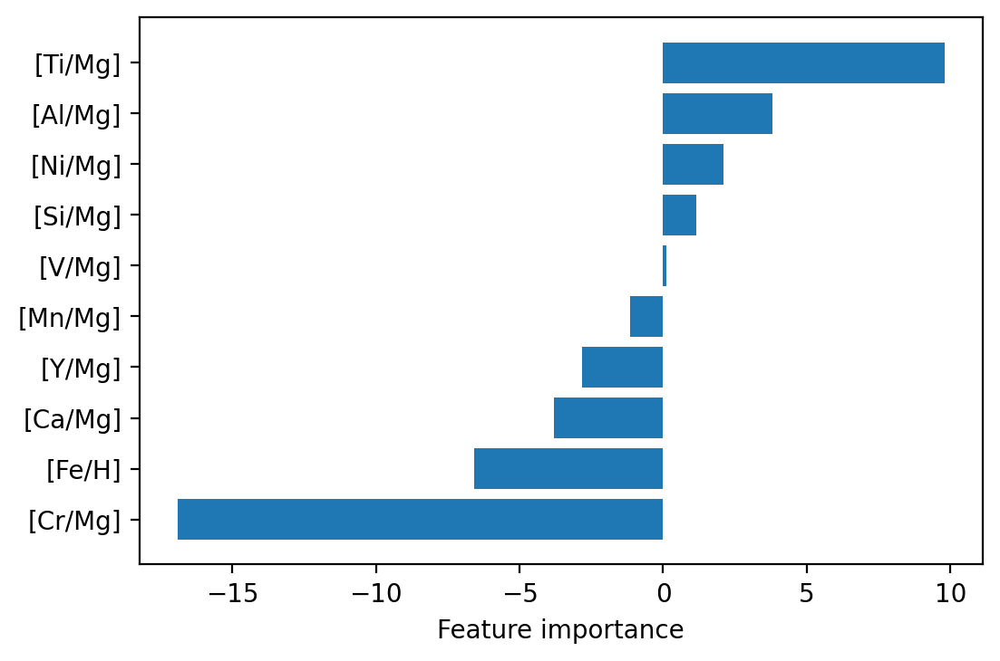

In [35]:
regression_cols = []
#regression_cols.append("bf18_Teff")
#regression_cols.append("bf18_log(g)")

for col in df.columns:
    if ("bf18_[" in col) & ("/Mg]" in col) & (col!="bf18_[M/H]"):
        regression_cols.append(col)

        
regression_cols.append("bf18_[Fe/H]")
regression_cols = np.array(regression_cols)
regressor_labels = [s.split("bf18_")[1] for s in regression_cols]
regressor_labels = np.array(regressor_labels)

#There are some pretty significant outliers which screw up the regression. Let's remove those.
for col in regression_cols:
    df = df[abs(df[col])<3]

model = LinearRegression()
X, y = df[regression_cols], df.cks_age
model.fit(X, y)

#Adjusted R-squared
print('Adjusted R-squared:', 1 - (1-model.score(X, y))*(len(y)-1)/(len(y)-X.shape[1]-1))

# Get importance
importance = model.coef_

order = np.argsort(importance)
importance = importance[order]
regressor_labels = regressor_labels[order]

# Summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# Plot feature importance
plt.barh([x for x in range(len(importance))], importance)
plt.yticks(np.arange(len(importance)), regressor_labels)
plt.xlabel("Feature importance")
plt.show()

### Solar twin sample: linear regression with abundances normalized to Fe

Adjusted R-squared: 0.9253398951395866
Feature: 0, Score: -80.29929
Feature: 1, Score: -62.33806
Feature: 2, Score: -53.88648
Feature: 3, Score: -46.55329
Feature: 4, Score: -18.50699
Feature: 5, Score: -6.06396
Feature: 6, Score: 3.13316
Feature: 7, Score: 5.16414
Feature: 8, Score: 15.17887
Feature: 9, Score: 16.94428
Feature: 10, Score: 41.66162
Feature: 11, Score: 50.73940
Feature: 12, Score: 60.95894


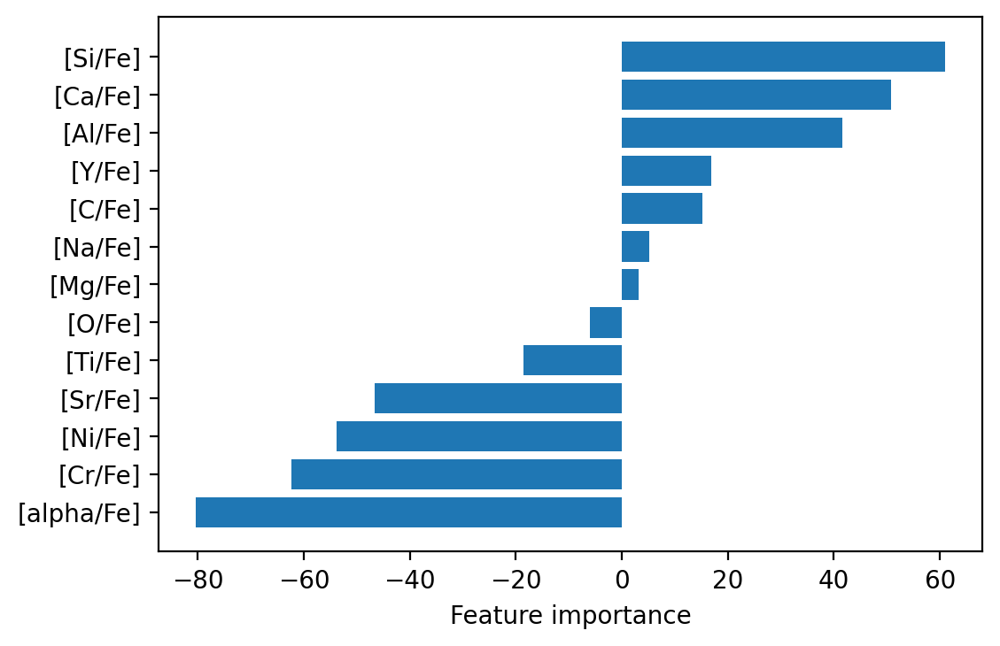

In [29]:
regression_cols = []

for col in nis.columns:
    if ("/Fe" in col):
        regression_cols.append(col)

regression_cols = np.array(regression_cols)
regressor_labels = [s for s in regression_cols]
regressor_labels = np.array(regressor_labels)

#There are some pretty significant outliers which screw up the regression. Let's remove those.
for col in regression_cols:
    nis = nis[abs(nis[col])<3]

model = LinearRegression()
X, y = nis[regression_cols], nis.Age
model.fit(X, y)

#Adjusted R-squared
print('Adjusted R-squared:', 1 - (1-model.score(X, y))*(len(y)-1)/(len(y)-X.shape[1]-1))

# Get importance
importance = model.coef_

order = np.argsort(importance)
importance = importance[order]
regressor_labels = regressor_labels[order]

# Summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# Plot feature importance
plt.barh([x for x in range(len(importance))], importance)
plt.yticks(np.arange(len(importance)), regressor_labels)
plt.xlabel("Feature importance")
plt.show()

### Linear regression with all abundances and abundance ratios

Adjusted R-squared: 0.5104832662269243


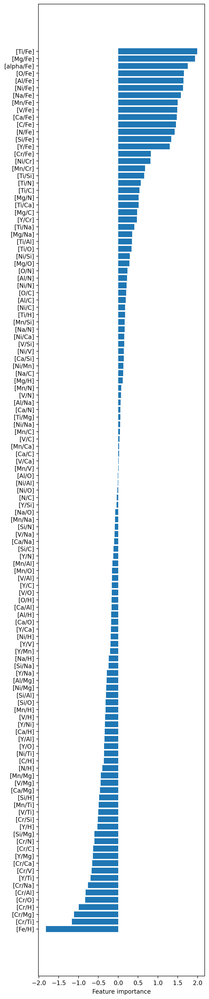

In [30]:
regression_cols = []

for col in df.columns:
    if ("bf18_[" in col) & (col!="bf18_[M/H]"): #& ('/Fe]' not in col): #& ('/H]' not in col):
        regression_cols.append(col)

regression_cols = np.array(regression_cols)
regressor_labels = [s.split("bf18_")[1] for s in regression_cols]
regressor_labels = np.array(regressor_labels)

#There are some pretty significant outliers which screw up the regression. Let's remove those.
for col in regression_cols:
    df = df[abs(df[col])<3]

model = LinearRegression()
X, y = df[regression_cols], df.cks_age
model.fit(X, y)

#Adjusted R-squared
print('Adjusted R-squared:', 1 - (1-model.score(X, y))*(len(y)-1)/(len(y)-X.shape[1]-1))

# Get importance
importance = model.coef_
order = np.argsort(importance)
importance = importance[order]
regressor_labels = regressor_labels[order]

# Summarize feature importance
#for i,v in enumerate(importance):
#    print(regressor_labels[i], 'Feature: %0d, Score: %.5f' % (i,v))
# Plot feature importance
#ax.barh(y_pos, performance, xerr=error, align='center')

plt.barh([x for x in range(len(importance))], importance)
plt.yticks(np.arange(len(importance)), regressor_labels)
plt.xlabel("Feature importance")
plt.gcf().set_size_inches(5,30)
plt.show()

In [31]:
#Print features in order of absolute importance
order = np.argsort(abs(importance))[::-1]

for i in range(len(importance)):
    print(regressor_labels[order][i], importance[order][i])

[Ti/Fe] 1.9896539896040215
[Mg/Fe] 1.933418557136007
[Fe/H] -1.8182151535613724
[alpha/Fe] 1.7530196887389344
[O/Fe] 1.65315937420995
[Al/Fe] 1.6432643253865895
[Ni/Fe] 1.631159160163529
[Na/Fe] 1.580904083723006
[Mn/Fe] 1.4991628860462383
[V/Fe] 1.4892534269376976
[Ca/Fe] 1.4769617736948826
[C/Fe] 1.45480374698373
[N/Fe] 1.4203074445979262
[Si/Fe] 1.3359865194767728
[Y/Fe] 1.2955778973097833
[Cr/Ti] -1.1676918103465965
[Cr/Mg] -1.1114563778785818
[Cr/H] -0.9962529743039515
[Cr/O] -0.8311971949525241
[Cr/Fe] 0.8219621792574261
[Cr/Al] -0.8213021461291629
[Ni/Cr] 0.8091969809061019
[Cr/Na] -0.7589419044655801
[Y/Ti] -0.6940760922942366
[Mn/Cr] 0.6772007067888138
[Cr/V] -0.6672912476802719
[Cr/Ca] -0.6549995944374568
[Ti/Si] 0.6536674701272479
[Y/Mg] -0.6378406598262245
[Cr/C] -0.6328415677263054
[Cr/N] -0.5983452653404999
[Si/Mg] -0.5974320376592334
[Ti/N] 0.5693465450060944
[Ti/C] 0.5348502426202921
[Y/H] -0.5226372562515927
[Cr/Si] -0.5140243402193488
[Mg/N] 0.5131111125380801
[Ti/Ca]

### Fitting a multivariate relation to the solar twin sample and CKS sample allowing for offsets in CKS data

In [32]:
#This definition of "Sun-like" comes from Nissen et al. 2020
n20_sun_like = (df.cks_Teff>5600)&(df.cks_Teff<5950)&\
               (df.p20_cks_slogg>4.2)&(df.p20_cks_slogg<4.53)&\
               (df['cks_[Fe/H]']>-0.3)&(df['cks_[Fe/H]']<0.3)

arg = n20_sun_like &\
     (np.isfinite(df["p20_cks_steff"])) &\
     (df["p20_cks_slogg"]) &\
     (df["p20_cks_smet"]) &\
     (df["cks_age"])

#Revised 8/27/2021
#Combined CKS + Nissen et al. 2020 data sets
# data = dict(y=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["ymg_ratio"][arg]), yerr=np.append(0.02*np.ones(len(nis)), df["ymg_ratio_err"][arg]),
#             x1=np.append(nis["Teff"], df["p20_cks_steff"][arg]), x1err=np.append(10.*np.ones(len(nis)), df["p20_cks_steff_err1"][arg]),
#             x2=np.append(nis["logg-sp"], df["p20_cks_slogg"][arg]), x2err=np.append(0.02*np.ones(len(nis)), df["p20_cks_slogg_err1"][arg]), 
#             x3=np.append(nis["[Fe/H]"], df["p20_cks_smet"][arg]), x3err=np.append(0.01*np.ones(len(nis)), df["p20_cks_smet_err1"][arg]),
#             x4=np.append(nis["Age"], df["cks_age"][arg]), x4err=np.append(nis["e_Age"], np.max([df["cks_e_age"][arg],df["cks_E_age"][arg]], axis=0)),
#             flag=np.append(['n20']*len(nis), ['cks']*len(df["cks_age"][arg])))

# data = dict(y=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["bf18_[Y/Mg]"][arg]), yerr=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Mg]"][arg]),
#             teff=np.append(nis["Teff"], df["p20_cks_steff"][arg]), eteff=np.append(10.*np.ones(len(nis)), df["p20_cks_steff_err1"][arg]),
#             logg=np.append(nis["logg-sp"], df["p20_cks_slogg"][arg]), elogg=np.append(0.02*np.ones(len(nis)), df["p20_cks_slogg_err1"][arg]), 
#             feh=np.append(nis["[Fe/H]"], df["p20_cks_smet"][arg]), efeh=np.append(0.01*np.ones(len(nis)), df["p20_cks_smet_err1"][arg]),
#             age=np.append(nis["Age"], df["cks_age"][arg]), eage=np.append(nis["e_Age"], np.max([df["cks_e_age"][arg],df["cks_E_age"][arg]], axis=0)),
#             flag=np.append(['n20']*len(nis), ['cks']*len(df["cks_age"][arg])))


#Reframing in terms of age
#age_ref = "bf18_Age"

source='spocs'

if source=='cks':
    data = dict(ymg=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["bf18_[Y/Mg]"][arg]), e_ymg=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Mg]"][arg]),
                yal=np.append(nis["[Y/Fe]"]-nis["[Al/Fe]"], df["bf18_[Y/Al]"][arg]), e_yal=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Al]"][arg]),
                teff=np.append(nis["Teff"], df["p20_cks_steff"][arg]), e_teff=np.append(10.*np.ones(len(nis)), df["p20_cks_steff_err1"][arg]),
                logg=np.append(nis["logg-sp"], df["p20_cks_slogg"][arg]), e_logg=np.append(0.02*np.ones(len(nis)), df["p20_cks_slogg_err1"][arg]), 
                feh=np.append(nis["[Fe/H]"], df["p20_cks_smet"][arg]), e_feh=np.append(0.01*np.ones(len(nis)), df["p20_cks_smet_err1"][arg]),
                age=np.append(nis["Age"], df["cks_age"][arg]), e_age=np.append(nis["e_Age"], np.max([df["cks_e_Age"][arg], df["cks_E_Age"][arg]], axis=0)),
                flag=np.append(['n20']*len(nis), ['cks']*len(df["cks_age"][arg])))
    
elif source=='spocs':
    data = dict(ymg=np.append(nis["[Y/Fe]"]-nis["[Mg/Fe]"], df["bf18_[Y/Mg]"][arg]), e_ymg=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Mg]"][arg]),
            yal=np.append(nis["[Y/Fe]"]-nis["[Al/Fe]"], df["bf18_[Y/Al]"][arg]), e_yal=np.append(0.02*np.ones(len(nis)), df["bf18_e_[Y/Al]"][arg]),
            teff=np.append(nis["Teff"], df["bf18_Teff"][arg]), e_teff=np.append(10.*np.ones(len(nis)), df["bf18_e_Teff"][arg]),
            logg=np.append(nis["logg-sp"], df["bf18_log(g)"][arg]), e_logg=np.append(0.02*np.ones(len(nis)), df["bf18_e_log(g)"][arg]), 
            feh=np.append(nis["[Fe/H]"], df["bf18_[Fe/H]"][arg]), e_feh=np.append(0.01*np.ones(len(nis)), df["bf18_e_[Fe/H]"][arg]),
            age=np.append(nis["Age"], df["bf18_Age"][arg]), e_age=np.append(nis["e_Age"], np.max([df["bf18_e_Age"][arg], df["bf18_E_Age"][arg]], axis=0)),
            flag=np.append(['n20']*len(nis), ['cks']*len(df["bf18_Age"][arg])))

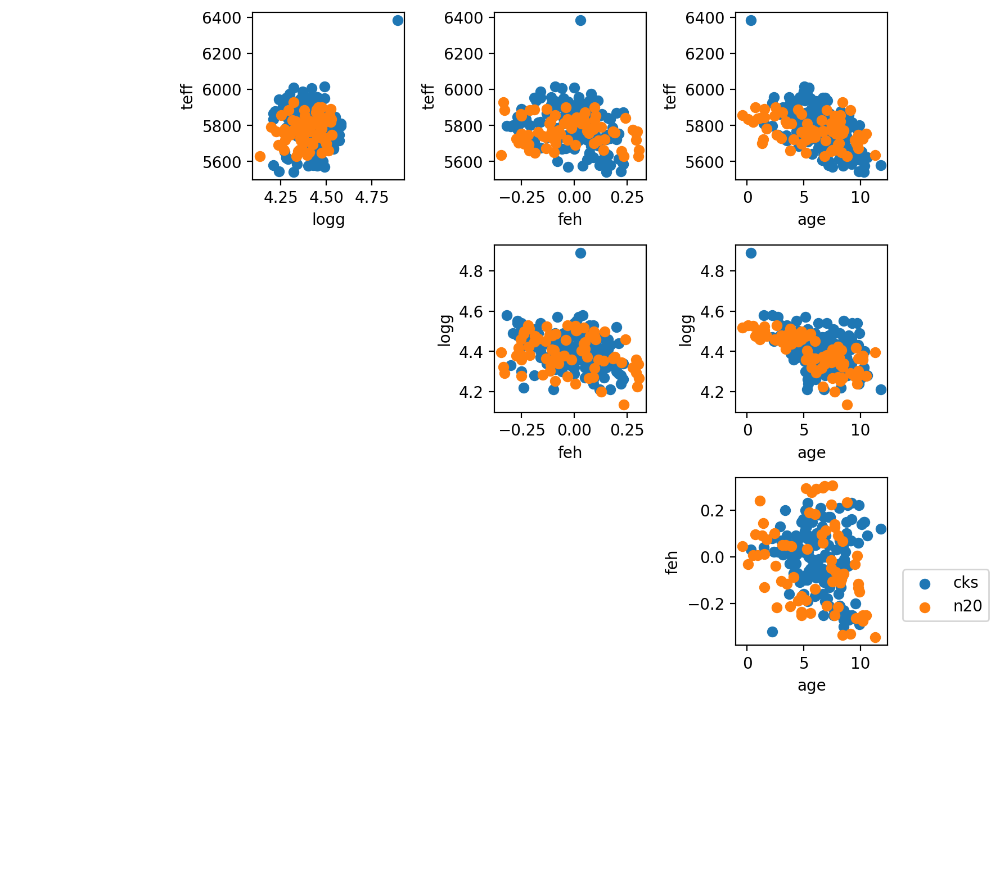

In [33]:
var = ['teff', 'logg', 'feh', 'age']

fig, ax = plt.subplots(nrows=len(var), ncols=len(var), figsize=(9,8))

for i in range(len(var)):
    v1 = var[i]
    for j in range(len(var)):
        v2 = var[j]
        
        for ref in np.unique(data["flag"]):
            arg = data['flag'] == ref
            
            x = data[v1][arg]
            y = data[v2][arg]
        
            if i>j:
                ax[j][i].scatter(x, y, label=ref)
                ax[j][i].set_xlabel(v1)
                ax[j][i].set_ylabel(v2)
            else:
                ax[j][i].axis('off')
        
        
ax[2][3].legend(bbox_to_anchor=(1.05, 0.5))
plt.tight_layout()

In [116]:
#import theano
import pymc3 as pm
import pymc3_ext as pmx
import aesara_theano_fallback.tensor as tt
import exoplanet as xo

print(pm.__version__)
print(xo.__version__)


with pm.Model() as model:  # model specifications in PyMC3 are wrapped in a with-statement
    # Define priors
    sigma_jit = pm.HalfCauchy("sigma_jit", beta=10, testval=1.0)
    sigma = pm.Deterministic("sigma", ((sigma_jit**2 + data["e_ymg"]**2))**0.5 )
        
    cks_c0 = pm.Normal("cks_c0", 0, sigma=20, testval=0)
    cks_c1 = pm.Normal("cks_c1", 0, sigma=20, testval=0)
    cks_trend = pm.Deterministic("cks_trend", cks_c0 * (data["flag"]=='cks') + cks_c1 * data["age"] * (data["flag"]=='cks'))
    
    theta0 = pm.Normal("theta0", 0, sigma=20, testval=0)        
    theta_teff = pm.Normal("theta_teff", 0, sigma=20)
    #theta_teff2 = pm.Normal("theta_teff2", 0, sigma=20)
    theta_logg = pm.Normal("theta_logg", 0, sigma=20)
    #theta_logg2 = pm.Normal("theta_logg2", 0, sigma=20)
    theta_feh  = pm.Normal("theta_feh", 0, sigma=20)
    theta_feh2  = pm.Normal("theta_feh2", 0, sigma=20)
    theta_age  = pm.Normal("theta_age", 0, sigma=20)
     
    teff_trend = pm.Deterministic("teff_trend", theta_teff*data["teff"])
    logg_trend = pm.Deterministic("logg_trend", theta_logg*data["logg"])
    feh_trend  = pm.Deterministic("feh_trend", theta_feh*data["feh"] + theta_feh2*data["feh"]**2)
    age_trend  = pm.Deterministic("age_trend", theta_age*data["age"])

    ymodel = pm.Deterministic("ymodel", 
                              theta0 + teff_trend + logg_trend + feh_trend + age_trend)    
    
    others = pm.Deterministic("others",
                              theta0 + teff_trend + logg_trend + feh_trend)
    
    #trend1 = pm.Deterministic("trend1", theta*data["x2"])
    #map_soln["theta0"]+data["x2"][arg]*map_soln["theta2"]+data["x3"][arg]*map_soln["theta3"]+data["x3"][arg]**2*map_soln["theta3b"]+data["x4"][arg]*map_soln["theta4"]
    
    # Define likelihood
    likelihood = pm.Normal("y", mu=ymodel, 
                                sigma=sigma, 
                                observed=data["ymg"] - cks_trend) #observed=data["y"] + yoffset)
    
    
    #if start is None:
    start = model.test_point     
    #map_soln = pmx.optimize(start=start, vars=[theta1, theta3, theta4])
    map_soln = pmx.optimize(start=start)
    map_soln = pmx.optimize(start=map_soln)

3.11.4
0.5.1


optimizing logp for variables: [theta_age, theta_feh2, theta_feh, theta_logg, theta_teff, theta0, cks_c1, cks_c0, sigma_jit]


message: Optimization terminated successfully.
logp: -229.25179232592563 -> 233.19025562698783


optimizing logp for variables: [theta_age, theta_feh2, theta_feh, theta_logg, theta_teff, theta0, cks_c1, cks_c0, sigma_jit]


message: Optimization terminated successfully.
logp: 233.19025562698783 -> 233.19025562698783


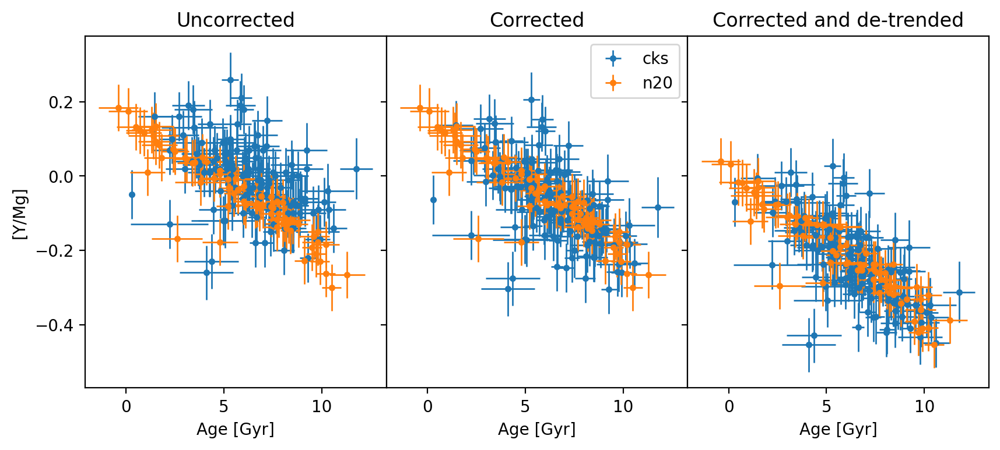

In [117]:
fig,ax = plt.subplots(nrows=1, ncols=3, sharex=True, sharey=True, figsize=(10,4))

eb_kws = {"alpha":1, "fmt":".", "lw":1}

for ref in np.unique(data["flag"]):
    arg = data["flag"] == ref
    #Uncorrected
    ax[0].errorbar(data["age"][arg], data["ymg"][arg], 
                   xerr=data["e_age"][arg], 
                   yerr=map_soln["sigma"][arg], 
                   label=ref, **eb_kws)
    #Corrected
    ax[1].errorbar(data["age"][arg], data["ymg"][arg]-map_soln["cks_trend"][arg], 
                   xerr=data["e_age"][arg], 
                   yerr=map_soln["sigma"][arg], 
                   label=ref, **eb_kws)
    
    #Corrected and de-trended
    ax[2].errorbar(data["age"][arg], data["ymg"][arg]-map_soln["cks_trend"][arg]-map_soln["others"][arg], 
                   xerr=data["e_age"][arg], 
                   yerr=map_soln["sigma"][arg], 
                   label=ref, **eb_kws)

    
    

ax[0].set_title('Uncorrected')
ax[1].set_title('Corrected')
ax[2].set_title('Corrected and de-trended')
ax[1].legend()    


for i in range(3):
    ax[i].set_xlabel('Age [Gyr]')

ax[0].set_ylabel('[Y/Mg]')

plt.subplots_adjust(wspace=0)
plt.show()

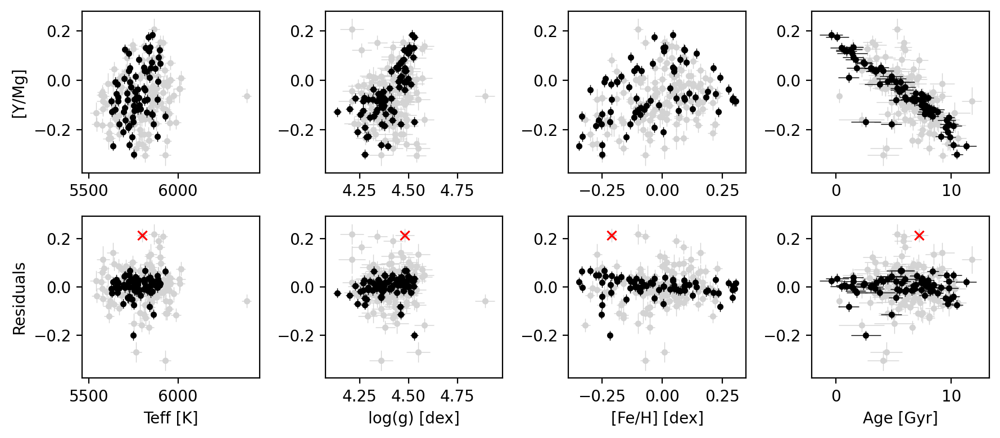

In [118]:
variables = ["teff","logg","feh","age"]

resid = data["ymg"]-map_soln["ymodel"]
rms = np.sqrt(np.median(resid ** 2))
outliers = abs(resid)/rms > 6

fig, (ax1,ax2) = plt.subplots(nrows=2,ncols=4,figsize=(9,4))

for i,v in enumerate(variables):
    ax2[i].plot(data[v][outliers], data["ymg"][outliers]-map_soln["cks_trend"][outliers]-(map_soln["ymodel"][outliers]), 'rx')
    ax2[i].plot(data[v][outliers], data["ymg"][outliers]-map_soln["cks_trend"][outliers]-(map_soln["ymodel"][outliers]), 'rx')
    
    for ref in np.unique(data["flag"]):
        arg = data["flag"]==ref

        if ref=='cks':

            ax1[i].errorbar(data[v][arg], data["ymg"][arg]-map_soln["cks_trend"][arg], xerr=data["e_"+v][arg], yerr=data["e_ymg"][arg], fmt='.', zorder=0, color='lightgrey', lw=0.5)
            ax2[i].errorbar(data[v][arg], data["ymg"][arg]-map_soln["cks_trend"][arg]-(map_soln["ymodel"][arg]), xerr=data["e_"+v][arg], yerr=data["e_ymg"][arg], fmt='.', zorder=0, color='lightgrey', lw=0.5)
            
               
        else:

            ax1[i].errorbar(data[v][arg], data["ymg"][arg], xerr=data["e_"+v][arg], yerr=data["e_ymg"][arg], fmt='.', zorder=1, color='k', lw=0.5)
            ax2[i].errorbar(data[v][arg], data["ymg"][arg]-(map_soln["ymodel"][arg]), xerr=data["e_"+v][arg], yerr=data["e_ymg"][arg], fmt='.', zorder=1, color='k', lw=0.5)
            
            
            
            
            
        #ax1[i].plot(data[v][np.argsort(data[v])], map_soln[v+"_trend"][np.argsort(data[v])], c='r')
    
ax1[0].set_ylabel("[Y/Mg]")
ax2[0].set_ylabel("Residuals")
ax2[0].set_xlabel("Teff [K]")
ax2[1].set_xlabel("log(g) [dex]")
ax2[2].set_xlabel("[Fe/H] [dex]")
ax2[3].set_xlabel("Age [Gyr]")
plt.tight_layout()

In [ ]:
#2021-09-09 DFM standup meeting:
# true age parameter: ymodel is fn of true age - leads to posteriors for each star
# cross validation on solar twins - leave out some solar twins, re-run procedure
# could add offset to solar twins and see if the offset is recovered - 
# mimicking CKS sample w/ left out solar twins
# background model could be broad model in abundance - could use pymc3 mixture distribution

# normal: y model - mean, other would be broad gaussian in abundance space - because outliers would be driving intrinsic scatter
# Send DFM the solar twin data

In [ ]:
#2021-09-10 Hogg
#How well does age predict each different abundance
#Information theory: age from a proxy, maximize information theory

#You also wouldn't use the input abundances as features becasue they're noisy. 
#Find latent surface that explains all of the data
#Every measurement you have is some noisy approximation of the truth...so you wouldn't do linear regression to predict isochrone ages. 
#You would fit a linear model that explains all of the data symmetrically
#Relationships between abundance and age
#Radial migration...

#Two variables that are correlated. both measured noisily. How you fit a line depends on the ratios of those errors. We're in that regime.
#Always do fit that age is a fn. of abundance - because it's easier to deal with noise on the dependent variable. If errors are very asymmetric, it's obvious how to do the problem.
#As soon as errors become comparable it is more complicated. 

#Does raw data that delivered the ages show breaks at 10 Gyr. Plot deviation from 10 Gyr isochrone.

#Make a model that is strictly linear with abundances. 
#Try to make the schmage have minimum scatter relative to the published ages.
#Only ask the published ages to be correct in their ordering of the stars. 
#Here's a linear combination of abundances that is monotonically related to ages. 
#And here's a subset. If you think so and so ages are correct, apply this non-linear correction and you'll get ages on that scale.

#What's the simplest abundance combination that is basically age.
#Schmages will be way more precise.

#Basic linear regression as an initialization. 
#Do individual 15 abundances to translate age. 16d surface. An initialization for the problem.
#Then ask how flexible do we want to be for the schmage to connect to age. Look at old school rank statistics. 
#Start at initial condition Optimize a rank statistic.
#Plot age vs. schmage colored by relative abundance ratios. 
#Gradients across the age-schmage relation would help make teh relation better. 
#Produce a slightly better model that describes that curve as well. 
#Create a generative model that generates everything and fit that model. 
#With a generative model you could include any data that you like. 
#You just compare it to the model where you happen to have the observations.
#Structure the generative model such that age is a latent parameter and you only generate abundances. Pull age through and abundances get generated.

#Everything to H or something well measured, or everything to Fe
#Mg/H and everything to Mg
#Objective function that isn't just a rank statistic. Something that stops it from blowing up. 
#Something like also asking the mean age to remain the same.
#Or more specific: the range of ages and the scatter of ages is the same. (difference in means squared and difference in variances squared)